# Citi Bike Trip NYC Case Study

This analysis examines the last month of bike-sharing data in NYC, sourced from [Citi Bike NYC](https://citibikenyc.com/system-data). The objective is to assess the impact of introducing an insurance coverage fee for trips exceeding 30 minutes and to provide insights into travel distances. The key points of analysis include:

- Total number of trips covered in the dataset.
- Estimating the potential revenue generated if a fee of $0.20 were charged for each ride exceeding 30 minutes.
- Analyzing trip distances by categorizing them into distance buckets (0-1 km, 2-4 km, 4-9 km, 10+ km) and visualizing the distribution in a diagram.

## Notes
- As of March 2, 2025, the most recent available dataset covers January 2025. Therefore, this analysis technically reflects data from the second most recent month rather than the last month.
- Travel distance buckets are assumed to be in kilometers and are defined as follows:
  - 0-1 km: [0, 2)
  - 2-4 km: [2, 4)
  - 4-9 km: [4, 10)
  - 10+ km: [10, ∞)
- The dataset for Jersey City (JC-202501-citibike-tripdata.csv.zip) is not considered for the analysis.
- Charges only apply to rides that exceed 30 minutes (excluding ride durations below or equal to exactly 30 minutes)

## 1. Data Ingestion, Exploration, and Preparation

This step involves downloading the dataset from the source, investigate it, and prepare it to answer the questions.

### 1.1 Data Ingestion

- Download the file
- Extract the zipped file
- Load file as a PySpark dataframe

In [0]:
import urllib.request
import zipfile
import os
import math

from pyspark.sql import functions as F
from pyspark.sql import types as T

# Define the URL and the local file paths
url = "https://s3.amazonaws.com/tripdata/202501-citibike-tripdata.zip"
zip_path = "/tmp/202501-citibike-tripdata.zip"
csv_path = "/tmp/*.csv"

# Download the zip file
urllib.request.urlretrieve(url, zip_path)

# Unzip the file
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall("/tmp")

# Load the CSV as a DataFrame
df_citibikenyc = spark.read.csv("file:" + csv_path, header=True, inferSchema=True)

# Display the DataFrame
display(df_citibikenyc)

ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
56BD148A05E26915,electric_bike,2025-01-01T22:19:06.324Z,2025-01-01T22:23:32.899Z,W 36 St & 7 Ave,6483.06,W 24 St & 7 Ave,6257.03,40.752149,-73.989539,40.74487634,-73.99529885,member
700CCCDF00C08077,electric_bike,2025-01-09T15:20:43.991Z,2025-01-09T15:26:19.137Z,Broadway & E 19 St,5980.11,W 24 St & 7 Ave,6257.03,40.73829,-73.99006,40.74487634,-73.99529885,member
B1A3FAFA5FE651CE,electric_bike,2025-01-01T12:54:26.571Z,2025-01-01T13:03:03.565Z,Jackson Ave & 46 Rd,6203.02,Crescent St & Broadway,6827.11,40.74524768,-73.94733276,40.7633589,-73.9286471,member
9CB0F28054BA5EBC,electric_bike,2025-01-14T13:43:59.151Z,2025-01-14T13:49:04.543Z,Broadway & E 19 St,5980.11,W 24 St & 7 Ave,6257.03,40.73829,-73.99006,40.74487634,-73.99529885,member
A1B8FDD4FAF0C2B2,electric_bike,2025-01-13T07:20:37.176Z,2025-01-13T07:29:18.015Z,Willis Ave & E 143 St,7798.02,1 Ave & E 110 St,7522.02,40.812299,-73.92037,40.7923272,-73.9383,member
D4ABC7DE51C4C0FD,electric_bike,2025-01-14T07:18:41.435Z,2025-01-14T07:27:23.496Z,Willis Ave & E 143 St,7798.02,1 Ave & E 110 St,7522.02,40.812299,-73.92037,40.7923272,-73.9383,member
A7566220F8801648,electric_bike,2025-01-04T16:35:52.575Z,2025-01-04T16:39:23.47Z,Grand Concourse & E 167 St,8126.07,Grand Concourse & E 156 St,7984.04,40.834263,-73.917641,40.823429,-73.924689,member
1D8751C74C3A0852,electric_bike,2025-01-07T07:27:46.047Z,2025-01-07T07:36:34.424Z,Willis Ave & E 143 St,7798.02,1 Ave & E 110 St,7522.02,40.812299,-73.92037,40.7923272,-73.9383,member
C2BBDB9AE51DF5C7,electric_bike,2025-01-01T06:02:31.418Z,2025-01-01T06:04:57.259Z,W 36 St & 7 Ave,6483.06,W 24 St & 7 Ave,6257.03,40.752149,-73.989539,40.74487634,-73.99529885,member
321F327A14D040DF,electric_bike,2025-01-08T06:10:20.634Z,2025-01-08T06:15:38.02Z,W 42 St & 8 Ave,6602.05,E 48 St & 5 Ave,6626.01,40.7575699,-73.99098507,40.75724567911726,-73.97805914282799,casual


### 1.2 Data Profiling

This part covers some basic data profiling tasks which extracts insights about the ingested data itself.

- The total number of rows ingested.
- Determining if the inferred schema is correct.
- Statistics about the data.
- Perform rudimentary data quality checks, such as empty or invalid values.

In [0]:
row_count = df_citibikenyc.count()
print("Total number of rows: " + str(row_count))

Total number of rows: 2124475


In [0]:
df_citibikenyc.printSchema()

root
 |-- ride_id: string (nullable = true)
 |-- rideable_type: string (nullable = true)
 |-- started_at: timestamp (nullable = true)
 |-- ended_at: timestamp (nullable = true)
 |-- start_station_name: string (nullable = true)
 |-- start_station_id: string (nullable = true)
 |-- end_station_name: string (nullable = true)
 |-- end_station_id: string (nullable = true)
 |-- start_lat: double (nullable = true)
 |-- start_lng: double (nullable = true)
 |-- end_lat: double (nullable = true)
 |-- end_lng: double (nullable = true)
 |-- member_casual: string (nullable = true)



__Conclusion:__ The schema inferred from the CSV files seem to be correct.

In [0]:
display(df_citibikenyc.summary())

summary,ride_id,rideable_type,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
count,2124475,2124475,2123911,2123911,2120500,2120153,2124475,2124475,2124206,2124206,2124475
mean,Infinity,null,null,5924.951078768049,null,5923.929563769707,40.73695340243622,-73.97156670346907,40.73683015868069,-73.97158357101263,null
stddev,NaN,null,null,1123.9238826094906,null,1118.5731324566104,0.04018066752084609,0.04161912373154124,0.0793027744593886,0.13110160942745672,null
min,000000105CDB6C86,classic_bike,1 Ave & E 110 St,2733.03,1 Ave & E 110 St,2733.03,34.014863,-118.481518,0.0,-118.481518,casual
25%,4.729981616803852E15,null,null,5259.06,null,5267.08,40.71323,-73.99147535,40.71334184275907,-73.9916,null
50%,1.875993100399E109,null,null,5980.1,null,5977.01,40.737006,-73.9790689945221,40.737006,-73.97950418293476,null
75%,Infinity,null,null,6726.01,null,6723.1,40.76017739537783,-73.95520135760307,40.76009437,-73.955613,null
max,FFFFF51CDD80E1B7,electric_bike,Yankee Ferry Terminal,Shop Morgan,Yankee Ferry Terminal,Shop Morgan,40.8863,-73.84672,40.95,0.0,member


__Conclusion:__ According to the statistics, some end latitudes and end longitudes are 0.0 which cannot be correct. Latitude around 0 means that it is at the same north/south-level as the equator while longitude 0 means that is is at the same west/east-level as Greenwhich. Both attributes would not apply to NYC.

### 1.3 Data Quality Checks

- Investigate why some end latitudes and longitudes are 0.0 and fix it (if possible).
- Perform rudimentary checks involving started and ended timestamps.

In [0]:
display(df_citibikenyc[df_citibikenyc.end_lng == 0.0])

ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
7CDB1FE9A882EF3A,classic_bike,2025-01-01T19:48:45.717Z,2025-01-01T19:53:32.73Z,White St & Moore St,4987.06,Bronx WH station,SYS018,40.704508,-73.9351,0.0,0.0,member
F1D6288930AF4537,electric_bike,2025-01-25T19:49:04.772Z,2025-01-25T19:52:41.445Z,Knickerbocker Ave & George St,4979.07,Bronx WH station,SYS018,40.704425,-73.92836,0.0,0.0,member
F280B66C0420563E,electric_bike,2025-01-15T06:59:03.223Z,2025-01-15T07:05:43.119Z,Broadway & Whipple St,4883.03,Bronx WH station,SYS018,40.7016657,-73.9437303,0.0,0.0,member
80ED725AE0051B35,electric_bike,2025-01-30T11:55:02.224Z,2025-01-30T11:58:34.585Z,Montrose Ave & Bushwick Ave,5068.02,Bronx WH station,SYS018,40.70767788,-73.94016171,0.0,0.0,casual
F8C9B2484C374C02,electric_bike,2025-01-27T06:45:10.787Z,2025-01-27T07:00:01.945Z,New York Ave & St Marks Ave,4098.06,Bronx WH station,SYS018,40.67514,-73.94716,0.0,0.0,member
C99FD2C522E0386B,electric_bike,2025-01-20T22:56:07.468Z,2025-01-20T23:07:22.865Z,Irving Ave & Harman St,4856.05,Bronx WH station,SYS018,40.70108,-73.9179,0.0,0.0,member


In [0]:
display(df_citibikenyc[df_citibikenyc.end_station_name == 'Bronx WH station'])

ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
7CDB1FE9A882EF3A,classic_bike,2025-01-01T19:48:45.717Z,2025-01-01T19:53:32.73Z,White St & Moore St,4987.06,Bronx WH station,SYS018,40.704508,-73.9351,0.0,0.0,member
F1D6288930AF4537,electric_bike,2025-01-25T19:49:04.772Z,2025-01-25T19:52:41.445Z,Knickerbocker Ave & George St,4979.07,Bronx WH station,SYS018,40.704425,-73.92836,0.0,0.0,member
F280B66C0420563E,electric_bike,2025-01-15T06:59:03.223Z,2025-01-15T07:05:43.119Z,Broadway & Whipple St,4883.03,Bronx WH station,SYS018,40.7016657,-73.9437303,0.0,0.0,member
80ED725AE0051B35,electric_bike,2025-01-30T11:55:02.224Z,2025-01-30T11:58:34.585Z,Montrose Ave & Bushwick Ave,5068.02,Bronx WH station,SYS018,40.70767788,-73.94016171,0.0,0.0,casual
F8C9B2484C374C02,electric_bike,2025-01-27T06:45:10.787Z,2025-01-27T07:00:01.945Z,New York Ave & St Marks Ave,4098.06,Bronx WH station,SYS018,40.67514,-73.94716,0.0,0.0,member
C99FD2C522E0386B,electric_bike,2025-01-20T22:56:07.468Z,2025-01-20T23:07:22.865Z,Irving Ave & Harman St,4856.05,Bronx WH station,SYS018,40.70108,-73.9179,0.0,0.0,member


__Conclusion:__ It looks like that trips that ends at _Bronx WH station_ do not provide a valid coordinate. After a Google search, this seems to be the subway station [Whitlock Avenue station](https://en.wikipedia.org/wiki/Whitlock_Avenue_station).

To fix the coordinates, the coordinates provided by the Wikipedia will be used to replace the 0.0:
- Latitude: 40.827514
- Longitude: -73.886147

In [0]:
# Update latitude and longitude
df_citibikenyc = df_citibikenyc.withColumn("end_lat", F.when(df_citibikenyc.end_lat == 0.0, 40.827514).otherwise(df_citibikenyc.end_lat))
df_citibikenyc = df_citibikenyc.withColumn("end_lng", F.when(df_citibikenyc.end_lng == 0.0, -73.886147).otherwise(df_citibikenyc.end_lng))

In [0]:
display(df_citibikenyc[df_citibikenyc.end_station_name == 'Bronx WH station'])

ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
7CDB1FE9A882EF3A,classic_bike,2025-01-01T19:48:45.717Z,2025-01-01T19:53:32.73Z,White St & Moore St,4987.06,Bronx WH station,SYS018,40.704508,-73.9351,40.827514,-73.886147,member
F1D6288930AF4537,electric_bike,2025-01-25T19:49:04.772Z,2025-01-25T19:52:41.445Z,Knickerbocker Ave & George St,4979.07,Bronx WH station,SYS018,40.704425,-73.92836,40.827514,-73.886147,member
F280B66C0420563E,electric_bike,2025-01-15T06:59:03.223Z,2025-01-15T07:05:43.119Z,Broadway & Whipple St,4883.03,Bronx WH station,SYS018,40.7016657,-73.9437303,40.827514,-73.886147,member
80ED725AE0051B35,electric_bike,2025-01-30T11:55:02.224Z,2025-01-30T11:58:34.585Z,Montrose Ave & Bushwick Ave,5068.02,Bronx WH station,SYS018,40.70767788,-73.94016171,40.827514,-73.886147,casual
F8C9B2484C374C02,electric_bike,2025-01-27T06:45:10.787Z,2025-01-27T07:00:01.945Z,New York Ave & St Marks Ave,4098.06,Bronx WH station,SYS018,40.67514,-73.94716,40.827514,-73.886147,member
C99FD2C522E0386B,electric_bike,2025-01-20T22:56:07.468Z,2025-01-20T23:07:22.865Z,Irving Ave & Harman St,4856.05,Bronx WH station,SYS018,40.70108,-73.9179,40.827514,-73.886147,member


In [0]:
# Check for null values in started_at and ended_at
display(df_citibikenyc[df_citibikenyc.started_at.isNull()])
display(df_citibikenyc[df_citibikenyc.ended_at.isNull()])

# Check for started_at that is later than ended_at
display(df_citibikenyc[df_citibikenyc.started_at > df_citibikenyc.ended_at])

ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual


ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual


ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual


__Conclusion:__ The (basic) checks for timestamps seem to be ok.

### 1.4 Data Preparation

Enrich the dataset to support with the analysis tasks.

- Add a column with ride duration in minutes.
- Add a column with ride distance in km.
- Add a categorical column for distance buckets.

#### 1.4.1 Ride Duration in Minutes

Add a new calculated column for ride duration by subtracting the started_at from ended_at and return the value as minutes.

In [0]:
df_citibikenyc_with_duration = df_citibikenyc.withColumn("trip_duration_minutes", (F.unix_timestamp(F.col("ended_at")) - F.unix_timestamp(F.col("started_at"))) / 60)
display(df_citibikenyc_with_duration)

ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual,trip_duration_minutes
56BD148A05E26915,electric_bike,2025-01-01T22:19:06.324Z,2025-01-01T22:23:32.899Z,W 36 St & 7 Ave,6483.06,W 24 St & 7 Ave,6257.03,40.752149,-73.989539,40.74487634,-73.99529885,member,4.433333333333334
700CCCDF00C08077,electric_bike,2025-01-09T15:20:43.991Z,2025-01-09T15:26:19.137Z,Broadway & E 19 St,5980.11,W 24 St & 7 Ave,6257.03,40.73829,-73.99006,40.74487634,-73.99529885,member,5.6
B1A3FAFA5FE651CE,electric_bike,2025-01-01T12:54:26.571Z,2025-01-01T13:03:03.565Z,Jackson Ave & 46 Rd,6203.02,Crescent St & Broadway,6827.11,40.74524768,-73.94733276,40.7633589,-73.9286471,member,8.616666666666667
9CB0F28054BA5EBC,electric_bike,2025-01-14T13:43:59.151Z,2025-01-14T13:49:04.543Z,Broadway & E 19 St,5980.11,W 24 St & 7 Ave,6257.03,40.73829,-73.99006,40.74487634,-73.99529885,member,5.083333333333333
A1B8FDD4FAF0C2B2,electric_bike,2025-01-13T07:20:37.176Z,2025-01-13T07:29:18.015Z,Willis Ave & E 143 St,7798.02,1 Ave & E 110 St,7522.02,40.812299,-73.92037,40.7923272,-73.9383,member,8.683333333333334
D4ABC7DE51C4C0FD,electric_bike,2025-01-14T07:18:41.435Z,2025-01-14T07:27:23.496Z,Willis Ave & E 143 St,7798.02,1 Ave & E 110 St,7522.02,40.812299,-73.92037,40.7923272,-73.9383,member,8.7
A7566220F8801648,electric_bike,2025-01-04T16:35:52.575Z,2025-01-04T16:39:23.47Z,Grand Concourse & E 167 St,8126.07,Grand Concourse & E 156 St,7984.04,40.834263,-73.917641,40.823429,-73.924689,member,3.5166666666666666
1D8751C74C3A0852,electric_bike,2025-01-07T07:27:46.047Z,2025-01-07T07:36:34.424Z,Willis Ave & E 143 St,7798.02,1 Ave & E 110 St,7522.02,40.812299,-73.92037,40.7923272,-73.9383,member,8.8
C2BBDB9AE51DF5C7,electric_bike,2025-01-01T06:02:31.418Z,2025-01-01T06:04:57.259Z,W 36 St & 7 Ave,6483.06,W 24 St & 7 Ave,6257.03,40.752149,-73.989539,40.74487634,-73.99529885,member,2.433333333333333
321F327A14D040DF,electric_bike,2025-01-08T06:10:20.634Z,2025-01-08T06:15:38.02Z,W 42 St & 8 Ave,6602.05,E 48 St & 5 Ave,6626.01,40.7575699,-73.99098507,40.75724567911726,-73.97805914282799,casual,5.3


In [0]:
df_citibikenyc_with_duration[df_citibikenyc_with_duration.trip_duration_minutes > 30].count()

58708

#### 1.4.2 Distance in km

Since only the start and end coordinates are provided, calculating the exact trip distance is challenging without knowing the precise route taken. To simplify the analysis, the distance will be estimated using the straight-line distance between the start and end coordinates.

In [0]:
# Source: https://stackoverflow.com/questions/27928/calculate-distance-between-two-latitude-longitude-points-haversine-formula

# Define the Haversine formula to calculate distance
def haversine_distance(lat1, lon1, lat2, lon2):
    try:
        R = 6371.0  # Radius of the Earth in km
        dlat = math.radians(lat2 - lat1)
        dlon = math.radians(lon2 - lon1)
        a = math.sin(dlat / 2) ** 2 + math.cos(math.radians(lat1)) * math.cos(math.radians(lat2)) * math.sin(dlon / 2) ** 2
        c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
        distance_km = R * c # Distance in km
    # Some rides do not have end coordinates, these will default as -1.0
    except:
        distance_km = -1.0
    return distance_km

# Register the UDF
haversine_udf = F.udf(haversine_distance, T.DoubleType())

# Calculate the distance and add it as a new column
df_citibikenyc_with_distance = df_citibikenyc_with_duration.withColumn(
    "trip_distance_km",
    haversine_udf(
        F.col("start_lat"),
        F.col("start_lng"),
        F.col("end_lat"),
        F.col("end_lng")
    )
)

display(df_citibikenyc_with_distance)

ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual,trip_duration_minutes,trip_distance_km
56BD148A05E26915,electric_bike,2025-01-01T22:19:06.324Z,2025-01-01T22:23:32.899Z,W 36 St & 7 Ave,6483.06,W 24 St & 7 Ave,6257.03,40.752149,-73.989539,40.74487634,-73.99529885,member,4.433333333333334,0.9430760531581052
700CCCDF00C08077,electric_bike,2025-01-09T15:20:43.991Z,2025-01-09T15:26:19.137Z,Broadway & E 19 St,5980.11,W 24 St & 7 Ave,6257.03,40.73829,-73.99006,40.74487634,-73.99529885,member,5.6,0.855080974142456
B1A3FAFA5FE651CE,electric_bike,2025-01-01T12:54:26.571Z,2025-01-01T13:03:03.565Z,Jackson Ave & 46 Rd,6203.02,Crescent St & Broadway,6827.11,40.74524768,-73.94733276,40.7633589,-73.9286471,member,8.616666666666667,2.555963377600048
9CB0F28054BA5EBC,electric_bike,2025-01-14T13:43:59.151Z,2025-01-14T13:49:04.543Z,Broadway & E 19 St,5980.11,W 24 St & 7 Ave,6257.03,40.73829,-73.99006,40.74487634,-73.99529885,member,5.083333333333333,0.855080974142456
A1B8FDD4FAF0C2B2,electric_bike,2025-01-13T07:20:37.176Z,2025-01-13T07:29:18.015Z,Willis Ave & E 143 St,7798.02,1 Ave & E 110 St,7522.02,40.812299,-73.92037,40.7923272,-73.9383,member,8.683333333333334,2.685038937671979
D4ABC7DE51C4C0FD,electric_bike,2025-01-14T07:18:41.435Z,2025-01-14T07:27:23.496Z,Willis Ave & E 143 St,7798.02,1 Ave & E 110 St,7522.02,40.812299,-73.92037,40.7923272,-73.9383,member,8.7,2.685038937671979
A7566220F8801648,electric_bike,2025-01-04T16:35:52.575Z,2025-01-04T16:39:23.47Z,Grand Concourse & E 167 St,8126.07,Grand Concourse & E 156 St,7984.04,40.834263,-73.917641,40.823429,-73.924689,member,3.5166666666666666,1.3427276670452908
1D8751C74C3A0852,electric_bike,2025-01-07T07:27:46.047Z,2025-01-07T07:36:34.424Z,Willis Ave & E 143 St,7798.02,1 Ave & E 110 St,7522.02,40.812299,-73.92037,40.7923272,-73.9383,member,8.8,2.685038937671979
C2BBDB9AE51DF5C7,electric_bike,2025-01-01T06:02:31.418Z,2025-01-01T06:04:57.259Z,W 36 St & 7 Ave,6483.06,W 24 St & 7 Ave,6257.03,40.752149,-73.989539,40.74487634,-73.99529885,member,2.433333333333333,0.9430760531581052
321F327A14D040DF,electric_bike,2025-01-08T06:10:20.634Z,2025-01-08T06:15:38.02Z,W 42 St & 8 Ave,6602.05,E 48 St & 5 Ave,6626.01,40.7575699,-73.99098507,40.75724567911726,-73.97805914282799,casual,5.3,1.0893217039707348


#### 1.4.3 Distance Buckets

An additional categorical attribute for distance buckets, defined with the following labels:

- [0-2 km]
- [2-4 km]
- [4-10 km]
- [10+ km]


In [0]:
df_citibikenyc_final = (df_citibikenyc_with_distance
  .withColumn("distance_category",
              F.when((df_citibikenyc_with_distance.trip_distance_km >= 0.0) & (df_citibikenyc_with_distance.trip_distance_km < 2.0), "0:[0-2 km]")
              .when((df_citibikenyc_with_distance.trip_distance_km >= 2.0) & (df_citibikenyc_with_distance.trip_distance_km < 4.0), "1:[2-4 km]")
              .when((df_citibikenyc_with_distance.trip_distance_km >= 4.0) & (df_citibikenyc_with_distance.trip_distance_km < 10.0), "2:[4-10 km]")
              .when(df_citibikenyc_with_distance.trip_distance_km >= 10.0, "3:[10+ km]")
              .otherwise("4:[N/A]")))

display(df_citibikenyc_final)

ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual,trip_duration_minutes,trip_distance_km,distance_category
56BD148A05E26915,electric_bike,2025-01-01T22:19:06.324Z,2025-01-01T22:23:32.899Z,W 36 St & 7 Ave,6483.06,W 24 St & 7 Ave,6257.03,40.752149,-73.989539,40.74487634,-73.99529885,member,4.433333333333334,0.9430760531581052,0:[0-2 km]
700CCCDF00C08077,electric_bike,2025-01-09T15:20:43.991Z,2025-01-09T15:26:19.137Z,Broadway & E 19 St,5980.11,W 24 St & 7 Ave,6257.03,40.73829,-73.99006,40.74487634,-73.99529885,member,5.6,0.855080974142456,0:[0-2 km]
B1A3FAFA5FE651CE,electric_bike,2025-01-01T12:54:26.571Z,2025-01-01T13:03:03.565Z,Jackson Ave & 46 Rd,6203.02,Crescent St & Broadway,6827.11,40.74524768,-73.94733276,40.7633589,-73.9286471,member,8.616666666666667,2.555963377600048,1:[2-4 km]
9CB0F28054BA5EBC,electric_bike,2025-01-14T13:43:59.151Z,2025-01-14T13:49:04.543Z,Broadway & E 19 St,5980.11,W 24 St & 7 Ave,6257.03,40.73829,-73.99006,40.74487634,-73.99529885,member,5.083333333333333,0.855080974142456,0:[0-2 km]
A1B8FDD4FAF0C2B2,electric_bike,2025-01-13T07:20:37.176Z,2025-01-13T07:29:18.015Z,Willis Ave & E 143 St,7798.02,1 Ave & E 110 St,7522.02,40.812299,-73.92037,40.7923272,-73.9383,member,8.683333333333334,2.685038937671979,1:[2-4 km]
D4ABC7DE51C4C0FD,electric_bike,2025-01-14T07:18:41.435Z,2025-01-14T07:27:23.496Z,Willis Ave & E 143 St,7798.02,1 Ave & E 110 St,7522.02,40.812299,-73.92037,40.7923272,-73.9383,member,8.7,2.685038937671979,1:[2-4 km]
A7566220F8801648,electric_bike,2025-01-04T16:35:52.575Z,2025-01-04T16:39:23.47Z,Grand Concourse & E 167 St,8126.07,Grand Concourse & E 156 St,7984.04,40.834263,-73.917641,40.823429,-73.924689,member,3.5166666666666666,1.3427276670452908,0:[0-2 km]
1D8751C74C3A0852,electric_bike,2025-01-07T07:27:46.047Z,2025-01-07T07:36:34.424Z,Willis Ave & E 143 St,7798.02,1 Ave & E 110 St,7522.02,40.812299,-73.92037,40.7923272,-73.9383,member,8.8,2.685038937671979,1:[2-4 km]
C2BBDB9AE51DF5C7,electric_bike,2025-01-01T06:02:31.418Z,2025-01-01T06:04:57.259Z,W 36 St & 7 Ave,6483.06,W 24 St & 7 Ave,6257.03,40.752149,-73.989539,40.74487634,-73.99529885,member,2.433333333333333,0.9430760531581052,0:[0-2 km]
321F327A14D040DF,electric_bike,2025-01-08T06:10:20.634Z,2025-01-08T06:15:38.02Z,W 42 St & 8 Ave,6602.05,E 48 St & 5 Ave,6626.01,40.7575699,-73.99098507,40.75724567911726,-73.97805914282799,casual,5.3,1.0893217039707348,0:[0-2 km]


## 2. Data Analysis

With the data prepared, the analysis focuses on the following key questions:

- How many trips would be covered?
- If your manager thinks we could charge 0.2 USD for each ride that takes longer than 30 minutes, how much revenue could we expect?
- Your manager wants to understand the travel distance in distance buckets (0-1,2-4,4-9,10+).Please make a diagram.

### 2.1 Trips Covered

> How many trips would be covered?

In [0]:
# Total trips available in the dataset
total_trips = df_citibikenyc_final.count()

# Total trips over 30 minutes
total_trips_over_30mins = df_citibikenyc_final[df_citibikenyc_final.trip_duration_minutes > 30].count()

print("Total trips: {}".format(total_trips))
print("Trips over 30 minutes: {}".format(total_trips_over_30mins))

Total trips: 2124475
Trips over 30 minutes: 58708


### 2.2 Revenue for 30+ Minute Trips

In [0]:
# Calculate the revenue for trips over 30 minutes by multiplying the number of affected trips with $0.20
revenue_for_trips_over_30mins = total_trips_over_30mins * 0.2

print("Revenue for trips over 30 minutes: ${}".format(revenue_for_trips_over_30mins))

Revenue for trips over 30 minutes: $11741.6


### 2.3 Trips Distribution

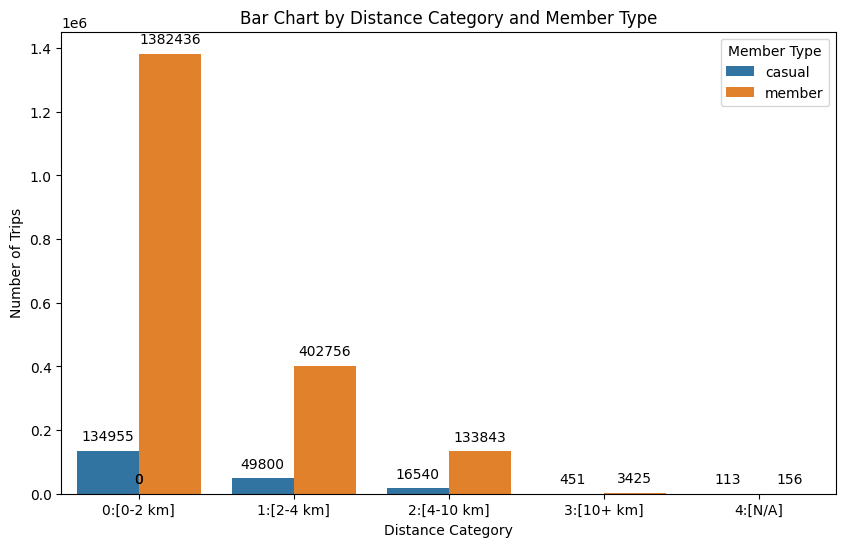

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt

# Convert Spark DataFrame to Pandas DataFrame
df_grouped_pd = df_citibikenyc_final.groupBy("distance_category", "member_casual").count().toPandas()

# Pivot the data for bar chart
df_pivot_pd = df_grouped_pd.pivot(index="distance_category", columns="member_casual", values="count").fillna(0)

# Plot the bar chart using seaborn
df_pivot_pd.reset_index(inplace=True)
df_melted = df_pivot_pd.melt(id_vars="distance_category", var_name="member_casual", value_name="count")

plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df_melted, x="distance_category", y="count", hue="member_casual", errorbar=None)

plt.xlabel('Distance Category')
plt.ylabel('Number of Trips')
plt.title('Bar Chart by Distance Category and Member Type')
plt.legend(title='Member Type')

# Add total number of rides on each bar
for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{int(height)}', (p.get_x() + p.get_width() / 2., height), ha='center', va='center', xytext=(0, 10), textcoords='offset points')

plt.show()

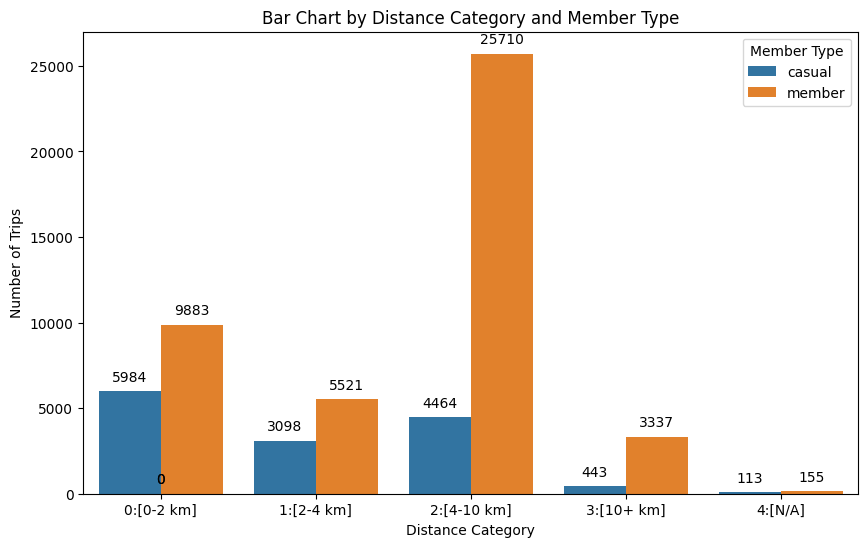

In [0]:
# Convert Spark DataFrame to Pandas DataFrame
df_grouped_pd = df_citibikenyc_final[df_citibikenyc_final.trip_duration_minutes > 30].groupBy("distance_category", "member_casual").count().toPandas()

# Pivot the data for bar chart
df_pivot_pd = df_grouped_pd.pivot(index="distance_category", columns="member_casual", values="count").fillna(0)

# Plot the bar chart using seaborn
df_pivot_pd.reset_index(inplace=True)
df_melted = df_pivot_pd.melt(id_vars="distance_category", var_name="member_casual", value_name="count")

plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df_melted, x="distance_category", y="count", hue="member_casual", errorbar=None)

plt.xlabel('Distance Category')
plt.ylabel('Number of Trips')
plt.title('Bar Chart by Distance Category and Member Type for Trips Longer than 30 Minutes')
plt.legend(title='Member Type')

# Add total number of rides on each bar
for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{int(height)}', (p.get_x() + p.get_width() / 2., height), ha='center', va='center', xytext=(0, 10), textcoords='offset points')

plt.show()

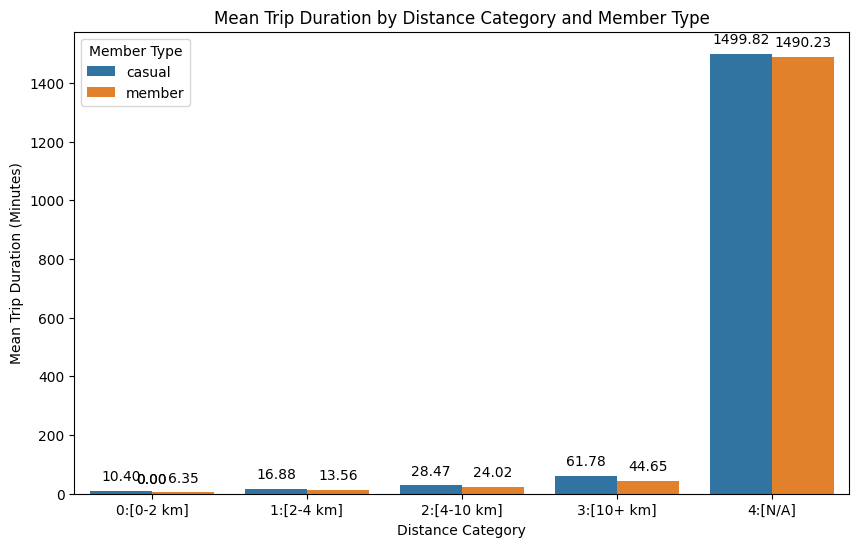

In [0]:
# Calculate mean trip duration minutes grouped by distance category and member type
df_mean_duration = df_citibikenyc_final.groupBy("distance_category", "member_casual").agg({"trip_duration_minutes": "mean"})

# Convert Spark DataFrame to Pandas DataFrame
df_mean_duration_pd = df_mean_duration.toPandas()

# Pivot the data for bar chart
df_pivot_mean_duration_pd = df_mean_duration_pd.pivot(index="distance_category", columns="member_casual", values="avg(trip_duration_minutes)").fillna(0)

# Plot the bar chart using seaborn
df_pivot_mean_duration_pd.reset_index(inplace=True)
df_melted_mean_duration = df_pivot_mean_duration_pd.melt(id_vars="distance_category", var_name="member_casual", value_name="mean_trip_duration_minutes")

plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df_melted_mean_duration, x="distance_category", y="mean_trip_duration_minutes", hue="member_casual", errorbar=None)

plt.xlabel('Distance Category')
plt.ylabel('Mean Trip Duration (Minutes)')
plt.title('Mean Trip Duration by Distance Category and Member Type')
plt.legend(title='Member Type')

# Add mean trip duration on each bar
for p in ax.patches:
    height = p.get_height()
    ax.annotate(f'{height:.2f}', (p.get_x() + p.get_width() / 2., height), ha='center', va='center', xytext=(0, 10), textcoords='offset points')

plt.show()

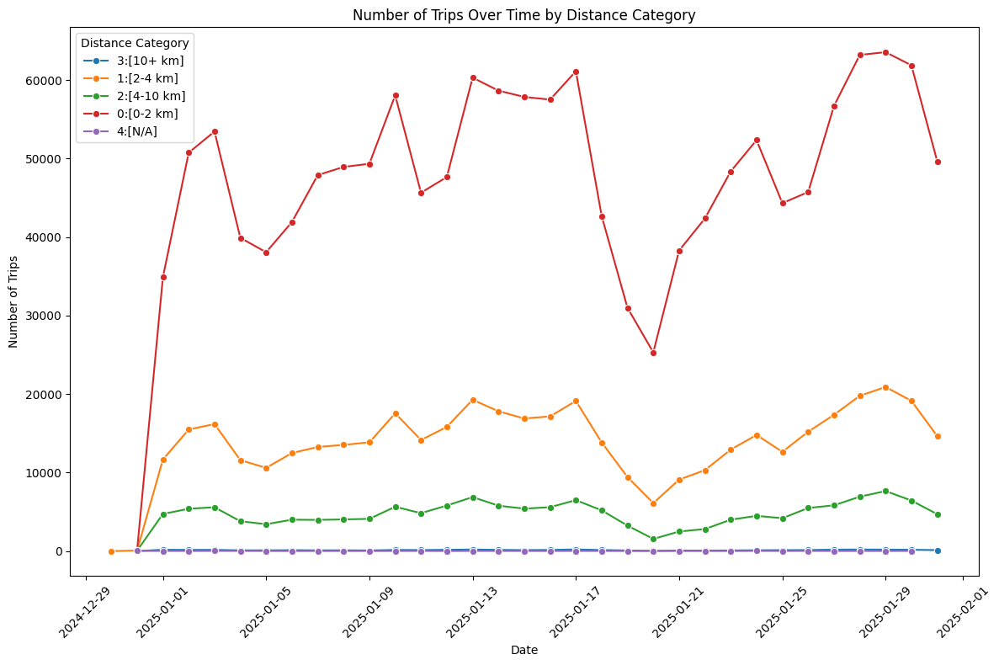

In [0]:
# Convert timestamp to date
df_citibikenyc_final_with_date = df_citibikenyc_final.withColumn("date", F.to_date("started_at"))

# Group by date and distance category, and count the number of trips
df_grouped_date = df_citibikenyc_final_with_date.groupBy("date", "distance_category").count()

# Convert Spark DataFrame to Pandas DataFrame
df_grouped_date_pd = df_grouped_date.toPandas()

# Plot the line chart using seaborn
plt.figure(figsize=(12, 8))
sns.lineplot(data=df_grouped_date_pd, x="date", y="count", hue="distance_category", marker="o")

plt.xlabel('Date')
plt.ylabel('Number of Trips')
plt.title('Number of Trips Over Time by Distance Category')
plt.legend(title='Distance Category')
plt.xticks(rotation=45)
plt.tight_layout()

plt.show()

__Conclusion:__ The first visualization shows that most rides fall into the [0-2 km] and [2-4 km] categories, with the majority of riders being members. The second visualization reveals that most trips lasting more than 30 minutes are in the [4-10 km] category. The third one, while expected, confirms that average trip durations increase linearly with distance. However, it also highlights an important detail: Trips with unusually long durations are missing from the categorization due to missing end coordinates. Lastly, the final visualization indicates a correlation between distance categories on certain dates.